# StarPhotometryFactory

- creation date : 27 juin 2019
- author Sylvie Dagoret


Create the calculation for phtometry

# Initialisation

## Import libraries

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import datetime

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx
import matplotlib.dates as mdates
from matplotlib import gridspec

import numpy as np
import pandas as pd

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

from scipy.interpolate import interp1d

from astropy.time import Time

import math as m

In [2]:
import os
from os import listdir
from os.path import isfile, join
import re
import sys

if not 'workbookDir' in globals():
    workbookDir = os.getcwd()
print('workbookDir: ' + workbookDir)

spectractordir=workbookDir+"/../../Spectractor"
print('spectractordir: ' + spectractordir)
toolsdir=workbookDir+"/../common_tools"
print("toolsdir:",toolsdir)


sys.path.append(workbookDir)
sys.path.append(spectractordir)
sys.path.append(os.path.dirname(workbookDir))
sys.path.append(toolsdir)

workbookDir: /Users/dagoret/MacOSX/GitHub/LSST/SpectractorAnaAtm19/ana_20190215_HD116405_Filtre_None
spectractordir: /Users/dagoret/MacOSX/GitHub/LSST/SpectractorAnaAtm19/ana_20190215_HD116405_Filtre_None/../../Spectractor
toolsdir: /Users/dagoret/MacOSX/GitHub/LSST/SpectractorAnaAtm19/ana_20190215_HD116405_Filtre_None/../common_tools


In [3]:
from astropy.table import Table,QTable

In [4]:
plt.rcParams["axes.labelsize"]="large"
plt.rcParams["axes.linewidth"]=2.0
plt.rcParams["xtick.major.size"]=8
plt.rcParams["ytick.major.size"]=8
plt.rcParams["ytick.minor.size"]=5
plt.rcParams["xtick.labelsize"]="large"
plt.rcParams["ytick.labelsize"]="large"

plt.rcParams["figure.figsize"]=(10,10)
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.titleweight'] = 'bold'
#plt.rcParams['axes.facecolor'] = 'blue'
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams['ytick.direction'] = 'out'
plt.rcParams['lines.markeredgewidth'] = 0.3 # the line width around the marker symbol
plt.rcParams['lines.markersize'] = 5  # markersize, in points
plt.rcParams['grid.alpha'] = 0.75 # transparency, between 0.0 and 1.0
plt.rcParams['grid.linestyle'] = '-' # simple line
plt.rcParams['grid.linewidth'] = 0.4 # in points
plt.rcParams['font.size'] = 13

In [5]:
from spectractor import parameters
from spectractor.extractor.extractor import Spectractor
from spectractor.logbook import LogBook
from spectractor.extractor.dispersers import *
from spectractor.extractor.spectrum import *
from spectractor.tools import ensure_dir

from libatmscattering import *


from astropy.table import Table,QTable
from astropy.io import ascii

# PhotUtil
from astropy.stats import sigma_clipped_stats

from photutils import aperture_photometry
from photutils import CircularAperture, CircularAnnulus
from astropy.visualization.mpl_normalize import (ImageNormalize,MinMaxInterval, SqrtStretch)

from photutils import DAOStarFinder


from photutils import make_source_mask
from astropy.stats import SigmaClip

## Define functions

In [6]:

######### CONFIGURATION

## wavelength
WLMIN = 380.0
WLMAX = 1000.0
#NBWLBIN = 62
NBWLBIN = 124
WLBINWIDTH = (WLMAX - WLMIN) / float(NBWLBIN)

WLMINBIN = np.arange(WLMIN, WLMAX, WLBINWIDTH)
WLMAXBIN = np.arange(WLMIN + WLBINWIDTH, WLMAX + WLBINWIDTH, WLBINWIDTH)
WLMEANBIN=(WLMINBIN + WLMAXBIN)/2.

print('WLMINBIN..................................=', WLMINBIN.shape, WLMINBIN)
print('WLMAXBIN..................................=', WLMAXBIN.shape, WLMAXBIN)
print('NBWLBIN...................................=', NBWLBIN)
print('WLBINWIDTH................................=', WLBINWIDTH)

WLMINBIN..................................= (124,) [380. 385. 390. 395. 400. 405. 410. 415. 420. 425. 430. 435. 440. 445.
 450. 455. 460. 465. 470. 475. 480. 485. 490. 495. 500. 505. 510. 515.
 520. 525. 530. 535. 540. 545. 550. 555. 560. 565. 570. 575. 580. 585.
 590. 595. 600. 605. 610. 615. 620. 625. 630. 635. 640. 645. 650. 655.
 660. 665. 670. 675. 680. 685. 690. 695. 700. 705. 710. 715. 720. 725.
 730. 735. 740. 745. 750. 755. 760. 765. 770. 775. 780. 785. 790. 795.
 800. 805. 810. 815. 820. 825. 830. 835. 840. 845. 850. 855. 860. 865.
 870. 875. 880. 885. 890. 895. 900. 905. 910. 915. 920. 925. 930. 935.
 940. 945. 950. 955. 960. 965. 970. 975. 980. 985. 990. 995.]
WLMAXBIN..................................= (124,) [ 385.  390.  395.  400.  405.  410.  415.  420.  425.  430.  435.  440.
  445.  450.  455.  460.  465.  470.  475.  480.  485.  490.  495.  500.
  505.  510.  515.  520.  525.  530.  535.  540.  545.  550.  555.  560.
  565.  570.  575.  580.  585.  590.  595.  600. 

In [7]:
## colors

# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NBWLBIN)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NBWLBIN), alpha=1)

In [8]:
#---------------------------------------------------------------------
def GetWLBin(wl):
    """

    :param wl: wavelength scalar
    :return: index
    """

    set_ibin = np.where(np.logical_and(WLMINBIN <= wl, WLMAXBIN > wl))[0]

    if len(set_ibin)==1:
        return set_ibin[0]
    else:
        return -1
#---------------------------------------------------------------------
def GETWLLabels():

    all_labels=[]
    for idx in np.arange(NBWLBIN):
        label="$\lambda$ : {:3.0f}-{:3.0f} nm".format(WLMINBIN[idx], WLMAXBIN[idx])
        all_labels.append(label)
    all_labels=np.array(all_labels)
    return all_labels
#------------------------------------------------------------------------

WLLABELS=GETWLLabels()

In [9]:
def weighted_avg_and_std(values, weights):
    """
    Return the weighted average and standard deviation.

    values, weights -- Numpy ndarrays with the same shape.

    For example for the PSF

    x=pixel number
    y=Intensity in pixel

    values-x
    weights=y=f(x)

    """
    average = np.average(values, weights=weights)
    variance = np.average((values - average) ** 2, weights=weights)  # Fast and numerically precise
    return average, np.sqrt(variance)

In [10]:
#-------------------------------------------------------------------------------------
def GetAllFiles(dir):
    """
    GetAllFiles(dir): provides the list of relevant files inside the directory dir


    :param dir: input directory pathname
    :return: list of files
    """



    # get all files
    onlyfiles = [f for f in listdir(dir) if isfile(join(dir, f))]
    onlyfiles = np.array(onlyfiles)

    # sort files
    sortedindexes = np.argsort(onlyfiles)
    onlyfiles = onlyfiles[sortedindexes]

    # get only _spectrum.fits file
    onlyfilesspectrum = []
    for file_name in onlyfiles:
        if re.search("^T.*_spectrum.fits$", file_name):
            # check if other files exits

            filetype = file_name.split('.')[-1]

            output_filename = os.path.basename(file_name)
            output_filename = os.path.join(dir, output_filename)
            output_filename_spectrogram = output_filename.replace('spectrum', 'spectrogram')
            output_filename_psf = output_filename.replace('spectrum.fits', 'table.csv')

            # go to next simulation if output files already exists
            if os.path.isfile(output_filename) and os.path.isfile(output_filename_spectrogram) and os.path.isfile(
                    output_filename_psf):
                filesize = os.stat(output_filename).st_size
                print(">>>>> output filename : {} already exists with size {} ".format(output_filename, filesize))

                filesize = os.stat(output_filename_spectrogram).st_size
                print(">>>>> output filename : {} already exists with size {} ".format(output_filename_spectrogram,
                                                                                       filesize))

                filesize = os.stat(output_filename_psf).st_size
                print(">>>>> output filename : {} already exists with size {} ".format(output_filename_psf, filesize))

                onlyfilesspectrum.append(re.findall("(^T.*_spectrum.fits$)", file_name)[0])

    # sort again all the files
    onlyfilesspectrum = np.array(onlyfilesspectrum)
    sortedindexes = np.argsort(onlyfilesspectrum)
    onlyfilesspectrum = onlyfilesspectrum[sortedindexes]

    # get basnemae of files for later use (to check if _table.csv and _spectrogram.fits exists
    onlyfilesbasename = []
    for f in onlyfilesspectrum:
        onlyfilesbasename.append(re.findall("(^T.*)_spectrum.fits$", f)[0])


    return onlyfilesspectrum,onlyfilesbasename
#------------------------------------------------------------------------------------------------------------------------------


In [11]:
def ReadAllFiles(dir, filelist):
    """

    ReadAllFiles(dir, filelist): Read all files

    :param dir: input directory
    :param filelist: list fo files
    :return: various containers
    """


    # init all container
    all_indexes=[]   # continuous index
    all_eventnum=[]  # event number on filename

    all_airmass=[]   #airmass

    all_lambdas = [] # wavelength

    #fluxes
    all_flux=[]
    all_errflux=[]


    # magnitudes
    all_mag=[]
    all_errmag=[]

    # absorption (Magnitude corrected from Rayleigh
    all_abs=[]
    all_errabs=[]


    all_dt       = []   # time since beginning in hours
    all_datetime = []   # datetime
    all_T=[]   # astropy time

    # preselection flag
    all_flag = []


    #bad indexes and filename
    all_badidx=[]
    all_badfn=[]


    all_BGimg=[]  # Background
    all_Rawimg = []  # Raw deflatted image

    NBSPEC = len(filelist)


    #----------------------------------
    # Extract spectra information from files
    # compute magnitudes
    #-----------------------------

    count=-1  #counter of good files before filtering

    # loop on all files
    for idx in np.arange(0, NBSPEC):
        if idx==322:
            print("SKIP bad file",filelist[idx] )
            continue

        count+=1

        theeventnum = int(filelist[idx].split(".")[1].split("_")[0])


        print(" read {}) : event {} , file {}".format(idx,theeventnum,filelist[idx]))


        fullfilename = os.path.join(dir, filelist[idx])
        fullfilename_spectrogram = fullfilename.replace('spectrum', 'spectrogram')
        rawfilename = filelist[idx].replace('_spectrum.fits', '.fit')
        fillrawfilename = os.path.join(rawinput_directory, rawfilename)



        #try:
        if 1:
            # read fits file
            hdu = fits.open(fullfilename)
            hdu2=fits.open(fullfilename_spectrogram)
            hdu3 = fits.open(fillrawfilename)





            # decode header
            header=hdu[0].header

            am=header["AIRMASS"]
            date=header["DATE-OBS"]

            # Astropy T0 time
            if idx==0:
                T0= Time(date, format='isot', scale='utc')

            # Astropy T time
            T=Time(date, format='isot', scale='utc')


            #datetime
            thedatetime=T.to_datetime()

            DT=(T-T0).sec/(3600.0)  # convert in hours


            # decode data
            data=hdu[0].data

            # extract wavelength, spectrum and errors
            wavelength=data[0,:]
            spec = data[1,:]
            err=data[2,: ]

            if(len(wavelength)==0 or len(spec)==0 or len(err)==0):
                print(">>>>>>>>>>>>>>  Empty file ",idx,")::",onlyfilesspectrum[idx] )
                print(">>>>>>>>>>>>>>>>>>>>>>>>>>>",len(wavelength)," , ",len(spec0), " , ",len(err))



            # sort the wavelengths
            wl_sorted_idx=np.argsort(wavelength)

            wl=wavelength[wl_sorted_idx]
            fl=spec[wl_sorted_idx]
            errfl=err[wl_sorted_idx]
            wlbins = [GetWLBin(w) for w in wl]
            wlbins = np.array(wlbins)


            # defines good measurmements as flux >0 and wavelength in selected bons
            goodpoints=np.where(np.logical_and(fl != 0, wlbins != -1))

            if(len(goodpoints)==0):
                print(">>>>>>>>>>>>>>  No Good points  ", idx, ")::", onlyfilesspectrum[idx])
                print(">>>>>>>>>>>>>>  No Good points  ", "wl = ",wl)
                print(">>>>>>>>>>>>>>  No Good points  ", "fl = ", fl)
                print(">>>>>>>>>>>>>>  No Good points  ", "errfl = ", errfl)



            # keep good points (wl,flux)
            wl=wl[goodpoints]
            fl=fl[goodpoints]
            errfl=errfl[goodpoints]


            # convert flux into magnitudes for each wavelength
            mag = -2.5 * np.log10(fl)
            errmag = errfl/fl

            #compute effective slant Rayleigh optical depth (not the vertical optical depth)
            od_adiab = RayOptDepth_adiabatic(wl,altitude=2890.5, costh=1./am)  # Rayleigh optical depth

            # absorption magnitude corrected from Rayleigh attenuation
            abs=mag-2.5/np.log(10.)*od_adiab
            errabs=errmag





            # save for each observation  { event-id, airmass, set of points (wl,flux,errflux, mag,abs,errabs) }
            if(len(mag>0)):
                #all_indexes.append(idx)
                all_indexes.append(count)
                all_eventnum.append(theeventnum)
                all_airmass.append(am)
                all_lambdas.append(wl)
                all_flux.append(fl)
                all_errflux.append(errfl)
                all_mag.append(mag)
                all_errmag.append(errmag)
                all_abs.append(abs)
                all_errabs.append(errabs)
                all_dt.append(DT)
                all_datetime.append(thedatetime)
                all_T.append(T)
                all_BGimg.append(hdu2[2].data)
                all_Rawimg.append(hdu3[0].data)

                absmin = abs.min()
                absmax = abs.max()


                # Set a quality flag
                if absmin < 25 or absmax > 32:
                    print("file index idx = ", count, "==>  filename = ", onlyfilesspectrum[idx], " absmin= ", absmin,
                          " absmax = ", absmax)
                    all_flag.append(False)
                    all_badidx.append(count)
                    all_badfn.append(onlyfilesspectrum[idx])
                else:
                    all_flag.append(True)



        #except:
        if 0:
            print("Unexpected error:", sys.exc_info()[0])
            pass

        #if count>10:
        #    break

    # transform container in numpy arrays
    all_indexes=np.array(all_indexes)
    all_eventnum = np.array(all_eventnum)

    all_airmass = np.array(all_airmass)

    all_lambdas = np.array(all_lambdas)

    all_flux = np.array(all_flux)
    all_errflux = np.array(all_errflux)


    all_mag=np.array(all_mag)
    all_errmag=np.array(all_errmag)

    all_abs = np.array(all_abs)
    all_errabs = np.array(all_errabs)

    all_dt = np.array(all_dt)
    all_datetime=np.array(all_datetime)

    all_flag = np.array(all_flag)

    all_badidx=np.array(all_badidx)
    all_badfn=np.array(all_badfn)


    return all_indexes,all_eventnum,all_airmass,all_lambdas,all_flux,all_errflux,all_mag,all_errmag,all_abs,all_errabs,all_dt,all_datetime,all_T,all_flag,all_badidx,all_badfn, all_BGimg,all_Rawimg

In [12]:
def FindSources(index,data,thresfact=50,fwhm=10.0):
    """
    """
    
    if index==194 or index==195 or index==83:
        data[:200,:200]=0
    
    if index==104:
        data[:300,:300]=0
    
    if index==83 or index==94 or 104:
        fwhm=5
        data[600:,600:]=0
        
    if index==187 :
        
        data[600:,:]=0
    
    mean, median, std = sigma_clipped_stats(data, sigma=3.0)
    daofind = DAOStarFinder(fwhm=fwhm, threshold=thresfact*std)    
    sources = daofind(data - median) 
    #sources = daofind(data) 
    return sources

In [13]:
r_star=25
r_in_bkg=40
r_out_bkg=50

In [14]:
def ComputePhotometry(vignette,x0,y0):
    gel=4.8 # electrons per ADU
    
    star_aperture= CircularAperture((x0,y0), r=r_star)
    
    theannulus_aperture = CircularAnnulus((x0,y0), r_in=r_in_bkg, r_out=r_out_bkg)
    theannulus_masks = theannulus_aperture.to_mask(method='center')
    theannulus_data = theannulus_masks[0].multiply(vignette)  # the annulus data image
    themask = theannulus_masks[0].data
    theannulus_data_1d = theannulus_data[themask > 0]
    _, themedian_sigclip, _ = sigma_clipped_stats(theannulus_data_1d)
    print("themedian_sigclip=",themedian_sigclip)
    thefullbg = np.full_like(theannulus_data, themedian_sigclip)
 
    thebg=theannulus_masks[0]*thefullbg

    theerror = np.sqrt(vignette/gel) # should be better calculated
    phot = aperture_photometry(vignette, star_aperture,error=theerror)
    phot['annulus_median'] = themedian_sigclip
    phot['aper_bkg'] = themedian_sigclip * star_aperture.area()
    phot['aper_sum_bkgsub'] = phot['aperture_sum'] - phot['aper_bkg']
    for col in phot.colnames:
        phot[col].info.format = '%.5g'  # for consistent table output
    print(phot)
    
    return phot

In [15]:
left  = 0  # the left side of the subplots of the figure
right = 0.99    # the right side of the subplots of the figure
bottom = 0.01   # the bottom of the subplots of the figure
top = 0.99      # the top of the subplots of the figure
wspace = 0   # the amount of width reserved for space between subplots,
               # expressed as a fraction of the average axis width
hspace = 0.2   # the amount of height reserved for space between subplots,
               # expressed as a fraction of the average axis height
plt.subplots_adjust(left=left, bottom=bottom, right=right, top=top, wspace=wspace, hspace=hspace)

<Figure size 720x720 with 0 Axes>

In [16]:
def ShowImages(all_images,all_titles):
    """
    ShowRawImages: Show the raw images without background subtraction
    ==============
    """
    #global all_images
    #global all_titles
    #global object_name

    NBIMGPERLROW=4
    NBIMAGES=len(all_images)
    MAXIMGROW=max(2,int(m.ceil(float(NBIMAGES)/float(NBIMGPERLROW))))

   
    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERLROW,figsize=(20,5*MAXIMGROW))
    plt.subplots_adjust(left=left, bottom=bottom, right=right, top=top, wspace=wspace, hspace=hspace)
    for index in np.arange(0,NBIMAGES):
        ix=int(index%NBIMGPERLROW)
        iy=int(index/NBIMGPERLROW)
        norm = ImageNormalize(all_images[index], interval=MinMaxInterval(),stretch=SqrtStretch())
        im=axarr[iy,ix].imshow(all_images[index],origin='lower',cmap='rainbow',norm=norm)
        thetitle="idx={}):".format(index)+all_titles[index]
        axarr[iy,ix].set_title(thetitle)
        axarr[iy,ix].grid(color='white', ls='solid')
        #axarr[iy,ix].text(1000.,1700,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
        axarr[iy,ix].grid(color='white', ls='solid')
    #title='Raw images of {}'.format(object_name)
    #plt.suptitle(title,size=16)    
    #figfilename=os.path.join(dir_top_images,'input_images.pdf')
    #plt.savefig(figfilename)  

In [17]:
def ShowSources(all_images,all_titles,all_sources):
    """
    ShowSources: Show the raw images and aperture
    ==============
    """
    #global all_images
    #global all_titles
    #global object_name

    NBIMGPERLROW=4
    NBIMAGES=len(all_images)
    MAXIMGROW=max(2,int(m.ceil(float(NBIMAGES)/float(NBIMGPERLROW))))

    all_selectedpos = []   

    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERLROW,figsize=(20,5*MAXIMGROW))
    plt.subplots_adjust(left=left, bottom=bottom, right=right, top=top, wspace=wspace, hspace=hspace)
    for index in np.arange(0,NBIMAGES):
        ix=int(index%NBIMGPERLROW)
        iy=int(index/NBIMGPERLROW)
        norm = ImageNormalize(all_images[index], interval=MinMaxInterval(),stretch=SqrtStretch())
        im=axarr[iy,ix].imshow(all_images[index],origin='lower',cmap='rainbow',norm=norm)
        thetitle="idx={}):".format(index)+all_titles[index]
        axarr[iy,ix].set_title(thetitle)
        axarr[iy,ix].grid(color='white', ls='solid')
        #axarr[iy,ix].text(1000.,1700,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
        axarr[iy,ix].grid(color='white', ls='solid')
        
        # this may depends on index
        
        thesource=all_sources[index]
        
        
        if len(thesource)!= 0:
        
        
            if len(thesource)>=2:
                all_x=thesource["xcentroid"]
                all_y=thesource["ycentroid"]       
        
                pidx=np.where(all_y==all_y.min())[0][0]
       
                x0=all_x[pidx]
                y0=all_y[pidx]
                
            else:
                pidx=0
                x0=thesource["xcentroid"][0]
                y0=thesource["ycentroid"][0]
        
            all_selectedpos.append((pidx,x0,y0))
        
            if x0!=0 and y0!=0 :
                star_aperture= CircularAperture((x0,y0), r=r_star)
                theannulus_aperture = CircularAnnulus((x0,y0), r_in=r_in_bkg, r_out=r_out_bkg)
        
                star_aperture.plot(color="red",lw=2,ax=axarr[iy,ix])
                theannulus_aperture.plot(color="yellow",lw=2,ax=axarr[iy,ix])
            
        else:
            all_selectedpos.append((0,0,0))
        
    #title='Raw images of {}'.format(object_name)
    #plt.suptitle(title,size=16)    
    #figfilename=os.path.join(dir_top_images,'input_images.pdf')
    #plt.savefig(figfilename)  
    return all_selectedpos

## Configuration

In [18]:
# where are the spectra
#----------------------
thedate = "20190215"
#input_directory = "/Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod3/" + thedate
input_directory = "/Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/" + thedate
rawinput_directory="/Users/dagoret/DATA/PicDuMidiFev2019/prod_"+thedate+"_v4"


In [19]:
gel=4.8 # electrons per ADU

# Main

## Get list of files

In [20]:
onlyfilesspectrum,onlyfilesbasename=GetAllFiles(input_directory)

>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190215_225550_730_HD116405_Filtre_None_bin1x1.1_red_spectrum.fits already exists with size 54720 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190215_225550_730_HD116405_Filtre_None_bin1x1.1_red_spectrogram.fits already exists with size 40700160 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190215_225550_730_HD116405_Filtre_None_bin1x1.1_red_table.csv already exists with size 640113 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190215_225626_007_HD116405_Filtre_None_bin1x1.2_red_spectrum.fits already exists with size 54720 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190215_225626_007_HD116405_Filtre_None_bin1x1.2_red_spectrogram.fits already exists with size 408297

>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190216_051349_401_HD116405_Filtre_None_bin1x1.458_red_spectrum.fits already exists with size 51840 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190216_051349_401_HD116405_Filtre_None_bin1x1.458_red_spectrogram.fits already exists with size 39464640 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190216_051349_401_HD116405_Filtre_None_bin1x1.458_red_table.csv already exists with size 627368 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190216_051424_679_HD116405_Filtre_None_bin1x1.459_red_spectrum.fits already exists with size 51840 
>>>>> output filename : /Users/dagoret/DATA/PicDuMidiFev2019/spectractor_output_prod4/20190215/T1M_20190216_051424_679_HD116405_Filtre_None_bin1x1.459_red_spectrogram.fits already exists with s

In [21]:
basenamecut=[]
for f in onlyfilesspectrum:
    basenamecut.append(f.split("_HD")[0])

## Read fits files

In [22]:
NBSPEC = len(onlyfilesspectrum)

print('NBSPEC....................................= ', NBSPEC)


all_indexes, all_eventnum, all_airmass, all_lambdas, all_flux, all_errflux, all_mag, all_errmag, all_abs, all_errabs, all_dt, all_datetime, all_T,all_flag, all_badidx, all_badfn, all_BGimg,all_Rawimg=\
        ReadAllFiles(input_directory, onlyfilesspectrum)



NBSPEC....................................=  348
 read 0) : event 1 , file T1M_20190215_225550_730_HD116405_Filtre_None_bin1x1.1_red_spectrum.fits
 read 1) : event 2 , file T1M_20190215_225626_007_HD116405_Filtre_None_bin1x1.2_red_spectrum.fits
 read 2) : event 3 , file T1M_20190215_225701_284_HD116405_Filtre_None_bin1x1.3_red_spectrum.fits
 read 3) : event 4 , file T1M_20190215_225736_562_HD116405_Filtre_None_bin1x1.4_red_spectrum.fits
 read 4) : event 5 , file T1M_20190215_225811_838_HD116405_Filtre_None_bin1x1.5_red_spectrum.fits
 read 5) : event 6 , file T1M_20190215_225847_115_HD116405_Filtre_None_bin1x1.6_red_spectrum.fits
 read 6) : event 7 , file T1M_20190215_225922_399_HD116405_Filtre_None_bin1x1.7_red_spectrum.fits
 read 7) : event 8 , file T1M_20190215_225957_677_HD116405_Filtre_None_bin1x1.8_red_spectrum.fits
 read 8) : event 9 , file T1M_20190215_230032_956_HD116405_Filtre_None_bin1x1.9_red_spectrum.fits
 read 9) : event 10 , file T1M_20190215_230108_233_HD116405_Filtre_No

 read 81) : event 82 , file T1M_20190215_234328_257_HD116405_Filtre_None_bin1x1.82_red_spectrum.fits
 read 82) : event 83 , file T1M_20190215_234403_534_HD116405_Filtre_None_bin1x1.83_red_spectrum.fits
 read 83) : event 84 , file T1M_20190215_234438_829_HD116405_Filtre_None_bin1x1.84_red_spectrum.fits
 read 84) : event 85 , file T1M_20190215_234514_107_HD116405_Filtre_None_bin1x1.85_red_spectrum.fits
 read 85) : event 86 , file T1M_20190215_234549_469_HD116405_Filtre_None_bin1x1.86_red_spectrum.fits
 read 86) : event 87 , file T1M_20190215_234624_749_HD116405_Filtre_None_bin1x1.87_red_spectrum.fits
 read 87) : event 88 , file T1M_20190215_234700_026_HD116405_Filtre_None_bin1x1.88_red_spectrum.fits
 read 88) : event 89 , file T1M_20190215_234735_303_HD116405_Filtre_None_bin1x1.89_red_spectrum.fits
 read 89) : event 90 , file T1M_20190215_234810_580_HD116405_Filtre_None_bin1x1.90_red_spectrum.fits
 read 90) : event 91 , file T1M_20190215_234845_858_HD116405_Filtre_None_bin1x1.91_red_spec

 read 166) : event 63 , file T1M_20190216_005131_383_HD116405_Filtre_None_bin1x1.63_red_spectrum.fits
 read 167) : event 64 , file T1M_20190216_005206_661_HD116405_Filtre_None_bin1x1.64_red_spectrum.fits
 read 168) : event 65 , file T1M_20190216_005241_938_HD116405_Filtre_None_bin1x1.65_red_spectrum.fits
 read 169) : event 66 , file T1M_20190216_005317_215_HD116405_Filtre_None_bin1x1.66_red_spectrum.fits
 read 170) : event 67 , file T1M_20190216_005352_494_HD116405_Filtre_None_bin1x1.67_red_spectrum.fits
 read 171) : event 68 , file T1M_20190216_005427_770_HD116405_Filtre_None_bin1x1.68_red_spectrum.fits
 read 172) : event 69 , file T1M_20190216_005503_048_HD116405_Filtre_None_bin1x1.69_red_spectrum.fits
 read 173) : event 70 , file T1M_20190216_005538_326_HD116405_Filtre_None_bin1x1.70_red_spectrum.fits
 read 174) : event 71 , file T1M_20190216_005613_605_HD116405_Filtre_None_bin1x1.71_red_spectrum.fits
 read 175) : event 73 , file T1M_20190216_005724_161_HD116405_Filtre_None_bin1x1.7

 read 247) : event 237 , file T1M_20190216_025332_552_HD116405_Filtre_None_bin1x1.237_red_spectrum.fits
 read 248) : event 238 , file T1M_20190216_025407_836_HD116405_Filtre_None_bin1x1.238_red_spectrum.fits
 read 249) : event 239 , file T1M_20190216_025443_120_HD116405_Filtre_None_bin1x1.239_red_spectrum.fits
 read 250) : event 240 , file T1M_20190216_025518_405_HD116405_Filtre_None_bin1x1.240_red_spectrum.fits
 read 251) : event 241 , file T1M_20190216_025553_689_HD116405_Filtre_None_bin1x1.241_red_spectrum.fits
 read 252) : event 242 , file T1M_20190216_025628_979_HD116405_Filtre_None_bin1x1.242_red_spectrum.fits
 read 253) : event 267 , file T1M_20190216_031111_229_HD116405_Filtre_None_bin1x1.267_red_spectrum.fits
 read 254) : event 268 , file T1M_20190216_031146_520_HD116405_Filtre_None_bin1x1.268_red_spectrum.fits
 read 255) : event 269 , file T1M_20190216_031221_813_HD116405_Filtre_None_bin1x1.269_red_spectrum.fits
 read 256) : event 270 , file T1M_20190216_031257_100_HD116405_F

 read 291) : event 356 , file T1M_20190216_040608_852_HD116405_Filtre_None_bin1x1.356_red_spectrum.fits
 read 292) : event 357 , file T1M_20190216_040644_146_HD116405_Filtre_None_bin1x1.357_red_spectrum.fits
 read 293) : event 358 , file T1M_20190216_040719_441_HD116405_Filtre_None_bin1x1.358_red_spectrum.fits
 read 294) : event 364 , file T1M_20190216_041051_213_HD116405_Filtre_None_bin1x1.364_red_spectrum.fits
 read 295) : event 365 , file T1M_20190216_041126_502_HD116405_Filtre_None_bin1x1.365_red_spectrum.fits
file index idx =  295 ==>  filename =  T1M_20190216_041126_502_HD116405_Filtre_None_bin1x1.365_red_spectrum.fits  absmin=  26.421605193515344  absmax =  32.3916568191284
 read 296) : event 372 , file T1M_20190216_042315_191_HD116405_Filtre_None_bin1x1.372_red_spectrum.fits
 read 297) : event 373 , file T1M_20190216_042350_533_HD116405_Filtre_None_bin1x1.373_red_spectrum.fits
 read 298) : event 374 , file T1M_20190216_042425_815_HD116405_Filtre_None_bin1x1.374_red_spectrum.fit

# Precut the image

In [23]:
all_vignettes=[img[0:1100,0:1100] for img in all_Rawimg]

In [24]:
#ShowImages(all_vignettes,basenamecut)

## Search the little star

In [25]:
#all_sources = [ FindSources(img,thresfact=100.,fwhm=10.) for img in all_vignettes]

In [26]:
all_sources = []
index=0

for img in all_vignettes:
    sources=FindSources(index,np.copy(img),thresfact=100.,fwhm=10.) 
    all_sources.append(sources)
    index+=1

2019-06-28 15:57:28  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:28  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:31  astropy    _showwarning         WARNING Sources were found, but none pass the sharpness and roundness criteria.
2019-06-28 15:57:31  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:31  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:31  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:31  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:46  astropy    _showwarning         WARNING Sources were found, but none pass the sharpness and roundness criteria.
2019-06-28 15:57:47  astropy    _showwarning         WARNING Sources were found, but none pass the sharpness and roundness criteria.
2019-06-28 15:57:47  astropy    _showwarning         WARNING Sources were found, but 

2019-06-28 15:57:55  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:55  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:55  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:55  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:56  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:56  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:56  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:56  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:56  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:56  astropy    _showwarning         WARNING No sources were found.
2019-06-28 15:57:57  astropy    _showwarning         WARNING No local peaks were found.
2019-06-28 15:57:57  astropy    _showwarning        

In [27]:
len(all_sources[0])

4

# debug

In [28]:
selnum=187

In [29]:
selectedvignette=all_vignettes[selnum]

In [30]:
norm = ImageNormalize(selectedvignette, interval=MinMaxInterval(),stretch=SqrtStretch())

In [31]:
sources=FindSources(selnum,selectedvignette,thresfact=10)

In [32]:
sources

id,xcentroid,ycentroid,sharpness,roundness1,roundness2,npix,sky,peak,flux,mag
int64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64
1,851.4824150707616,529.9042959474297,0.455213291769593,0.42848050298746715,-0.2545277667281062,49,0.0,7850.726414732002,3.362928158444054,-1.3167939741707846
2,854.1089093756116,533.0443390873323,0.3584111333481284,0.5957604893131235,0.48142215490101603,49,0.0,9681.903545034413,3.0015631920657397,-1.193368727531047
3,863.0106666196208,540.2950464104412,0.42424160058597526,0.5947977326403053,-0.4641996039411996,49,0.0,9637.295844641378,4.1997424867644355,-1.55805665456269
4,866.7738210020838,542.5316496280684,0.3713150466277136,0.8977601373891704,0.17130981635301162,49,0.0,6471.707820754082,2.640065674775136,-1.05403682649056


In [33]:
x0=sources["xcentroid"][0]
y0=sources["ycentroid"][0]

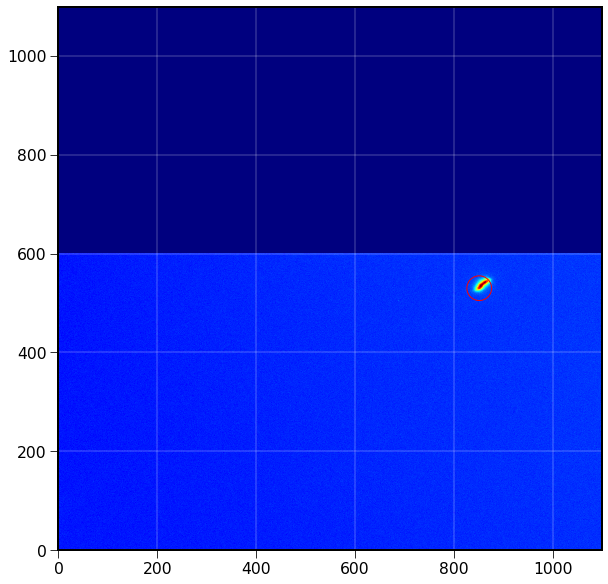

In [34]:
plt.imshow(selectedvignette,origin="lower",cmap="jet",norm=norm)
star_aperture=star_aperture= CircularAperture((x0,y0), r=r_star)
star_aperture.plot(color="r")
plt.grid(color="w")

## Show selected stars

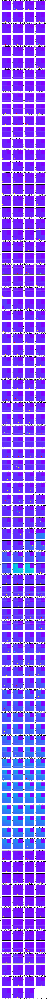

In [35]:
result=ShowSources(all_vignettes,basenamecut,all_sources)